Learn YOLO

In [ ]:
# ! pip install ultralytics

In [ ]:
# from ultralytics import YOLO # import YOLO algorithm for detection, classification or segmentation
# from IPython.display import display , Image # to display images

In [ ]:
# !yolo task=detect mode=predict  model=yolov8n.pt  conf=0.25 source='https://media.roboflow.com/notebooks/...
# Task= detect, classify or segment
# mode= predict, train or val
# mode= yolov8n.pt (nano), yolov8s.pt (small), yolov8m.pt (medium), yolov8l.pt (large) or yolov8x.pt (xlarge)
# conf= 0.25 > size of bounding box if > 0.25 then it's class
# source= source of image

In [ ]:
# display image
# Image(filename='source', height=500)

In [ ]:
# import os
# os.system('rm -r /content/runs')

# ⚡ Before you start
Let's make sure that we have access to GPU. We can use nvidia-smi command to do that. In case of any problems navigate to Edit -> Notebook settings -> Hardware accelerator, set it to GPU, and then click Save.

In [ ]:
# run on GPU from Runtime bar then change runtime types
# show type GPU
!nvidia-smi # Tesla T4

Sat Jul 15 21:13:47 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   36C    P8     9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

+ Classes
  - Military > labels
  - Civilian > unlabeled
  <!-- - Armed military > labels -->
  <!-- - Armed civilian > unlabeled -->
  <!-- - Tank -->

Connecting to the google drive


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Install YOLOv8:

In [ ]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 603.9/603.9 kB 11.6 MB/s eta 0:00:00


## 🔥 Train civilian model

+ Data augmentation: --augment
+ Hyperparameters: lr0=0.001, batch=32
+ Loss function: --loss <custom_loss>
+ Regularization: weight_decay=0.0001 dropout=0.2

In [ ]:
!yolo task=detect mode=train model=yolov8x.pt data=/content/drive/MyDrive/detect_terrorists/civilian_dataset/data.yaml epochs=200 imgsz=640 batch=32 lr0=0.001 weight_decay=0.0001 dropout=0.2 project=/content/drive/MyDrive/detect_terrorists/training_results name=civilian --augment

WARNING ⚠️ '--augment' does not require leading dashes '--', updating to 'augment'.
100% 131M/131M [00:00<00:00, 145MB/s]
Ultralytics YOLOv8.0.135 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=detect, mode=train, model=yolov8x.pt, data=/content/drive/MyDrive/detect_terrorists/civilian_dataset/data.yaml, epochs=200, patience=50, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/detect_terrorists/training_results, name=civilian, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, overlap_mask=True, mask_ratio=4, dropout=0.2, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labe

In [ ]:
# !ls {HOME}/runs/detect/train/

## ⚖️ Evaluate civilian model

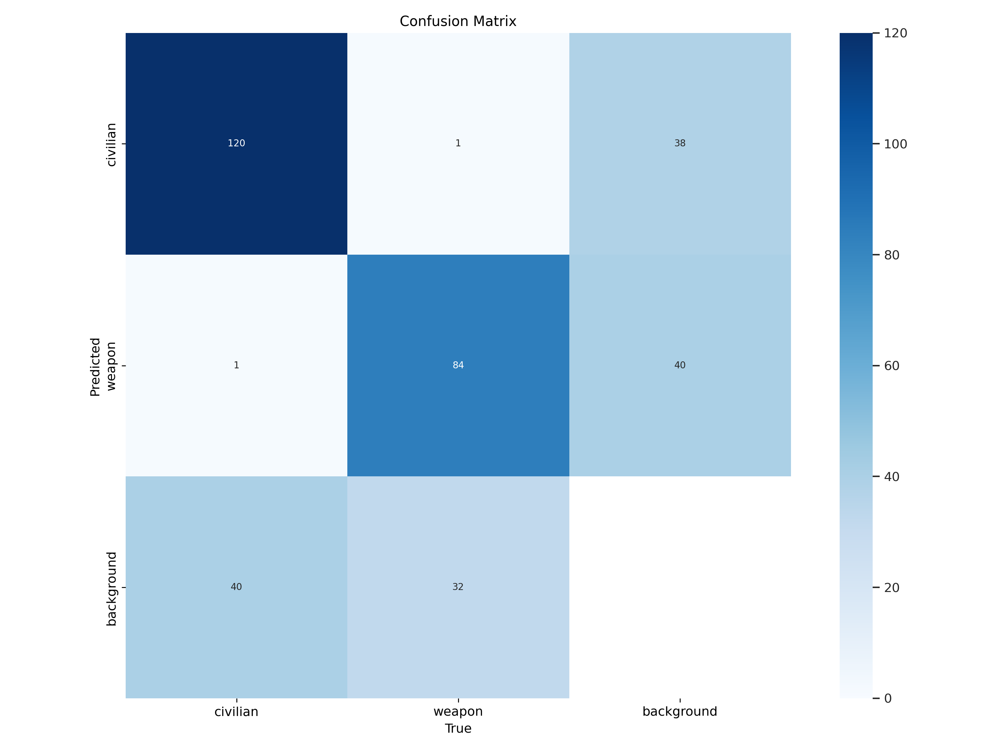

In [ ]:
from IPython.display import Image
Image(filename='/content/drive/MyDrive/detect_terrorists/training_results/civilian/confusion_matrix.png', width=1000)

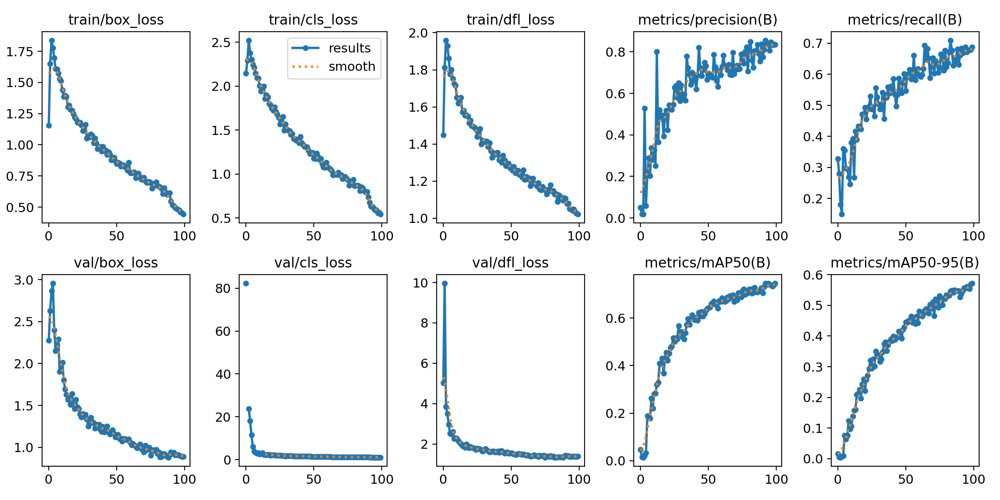

In [ ]:
Image(filename='/content/drive/MyDrive/detect_terrorists/training_results/civilian/results.png', width=1000)

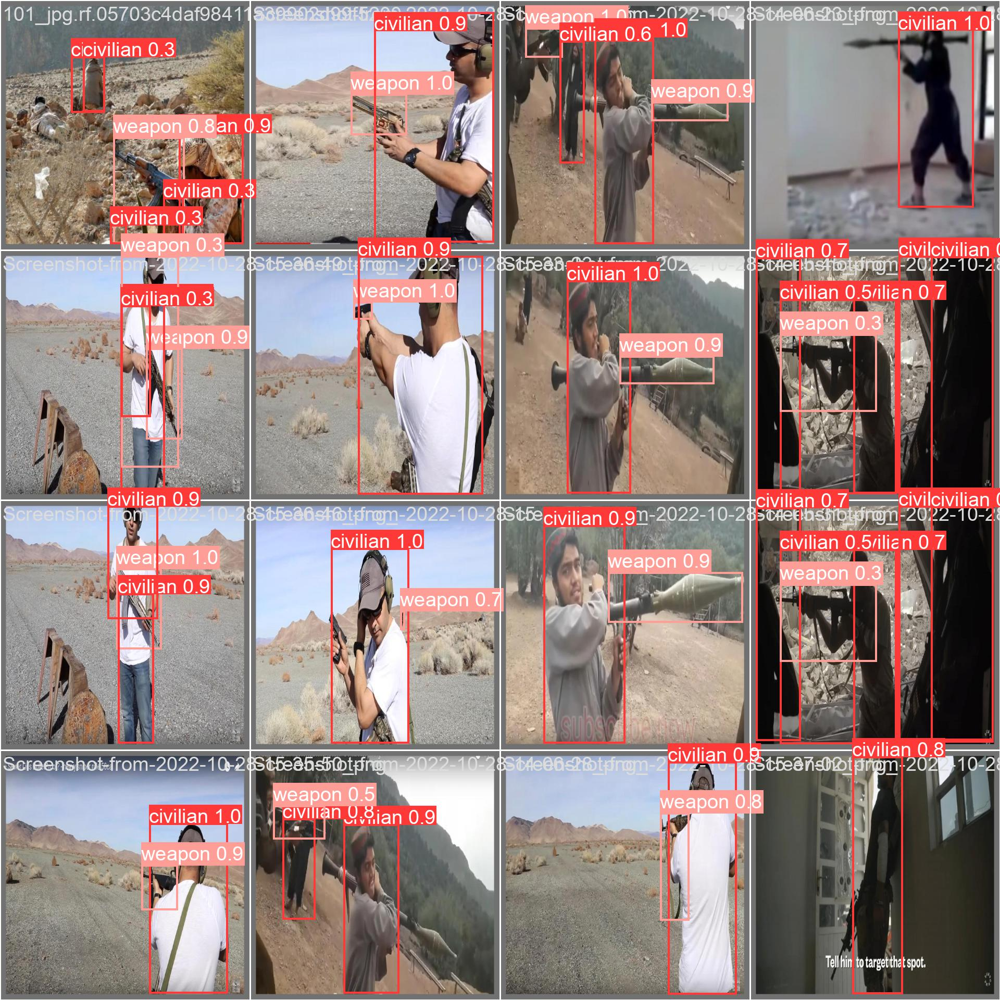

In [ ]:
Image(filename='/content/drive/MyDrive/detect_terrorists/training_results/civilian/val_batch0_pred.jpg', width=1000)

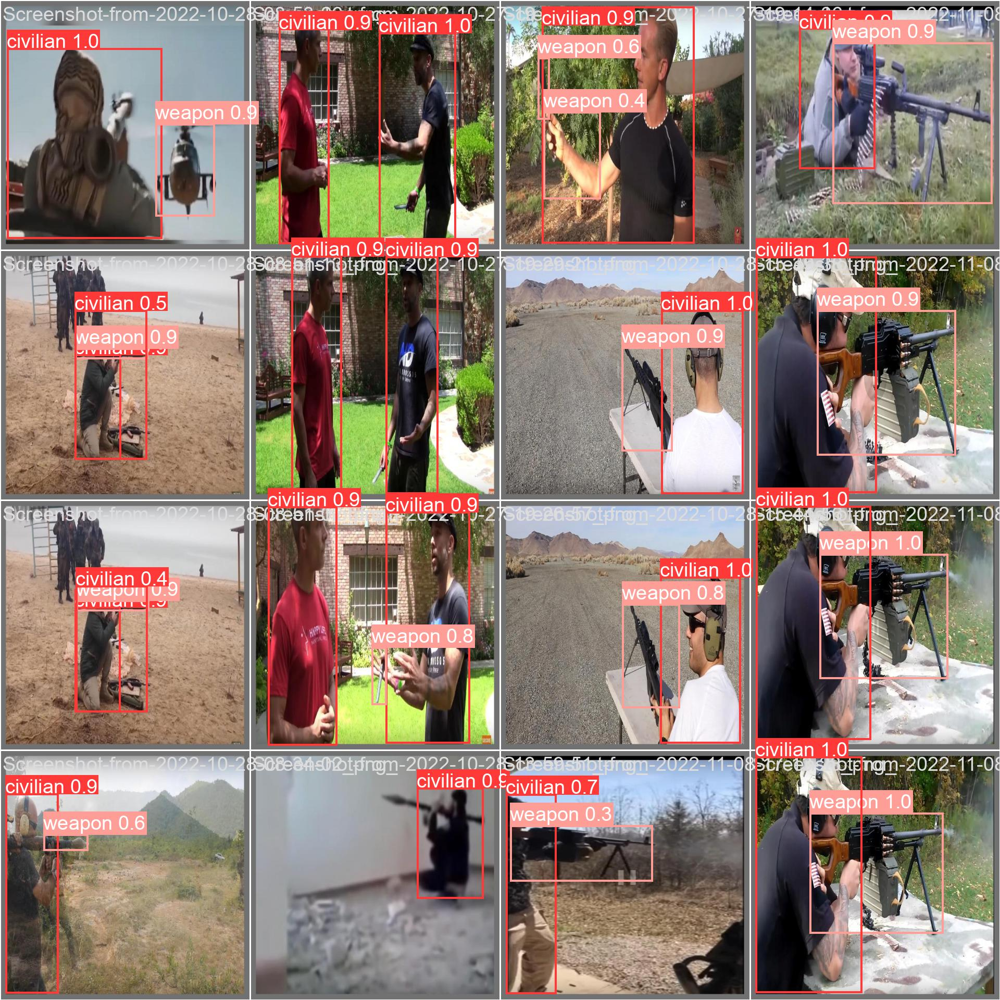

In [ ]:
Image(filename='/content/drive/MyDrive/detect_terrorists/training_results/civilian/val_batch1_pred.jpg', width=1000)

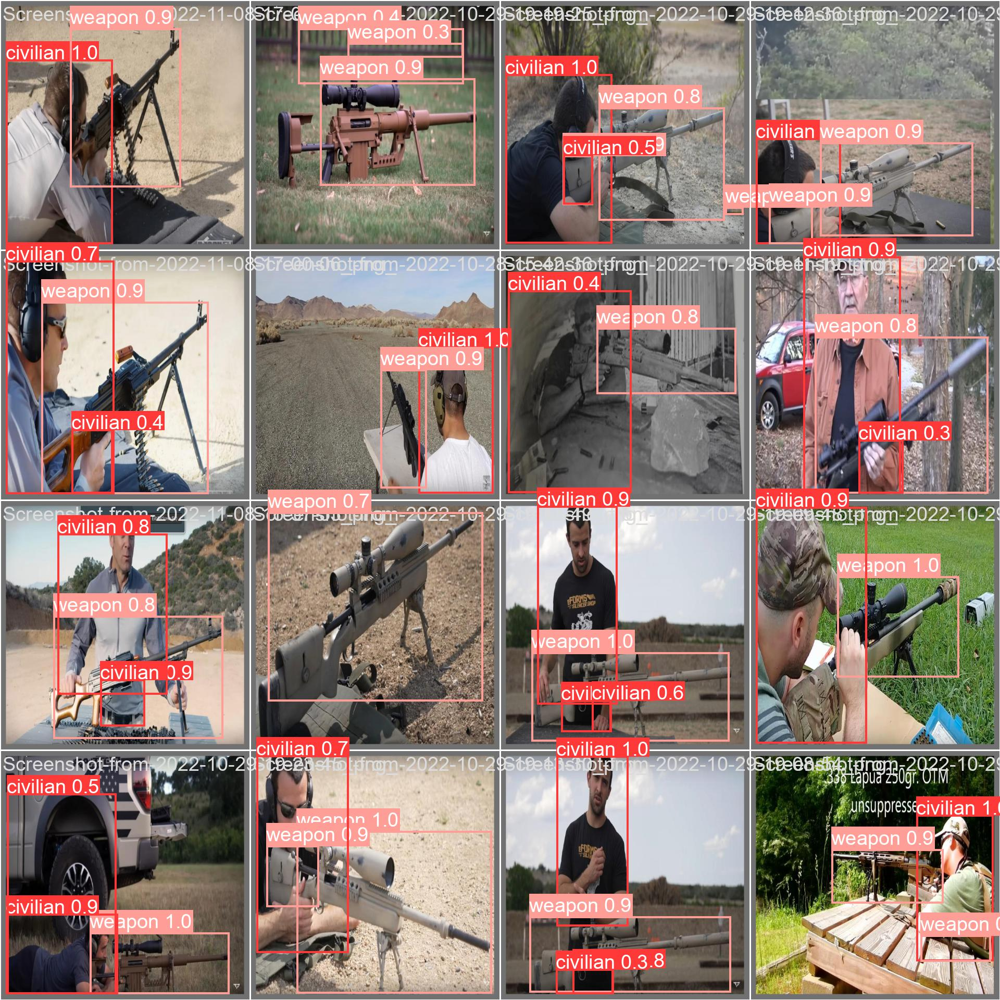

In [ ]:
Image(filename='/content/drive/MyDrive/detect_terrorists/training_results/civilian/val_batch2_pred.jpg', width=1000)

## 🔥 Predict civilian model

**NOTE:** As with the regular YOLOv8 training, we can now take a look at artifacts stored in `runs` directory.

In [ ]:
import glob
import matplotlib.pyplot as plt
from PIL import Image

Befor predict

In [ ]:
# one image
# for image_path in glob.glob(f'{HOME}/runs/detect/predict/*.jpg')[:3]:
#       display(Image(filename=image_path, width=600))
#       print("\n")

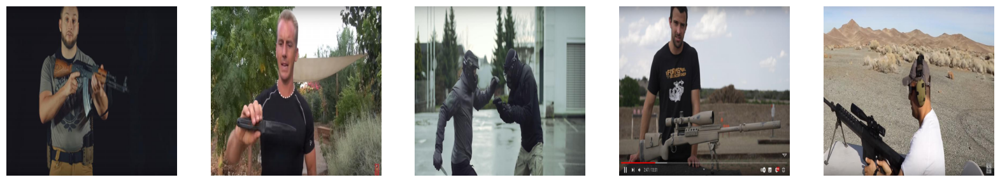

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=5, figsize=(20, 4))
image_paths = glob.glob("/content/drive/MyDrive/detect_terrorists/civilian_dataset/test/images/*.jpg")[:5]

for i, img_path in enumerate(image_paths):
    img = Image.open(img_path)
    axes[i].imshow(img)
    axes[i].axis("off")
plt.show()

Predict

In [ ]:
!yolo task=detect mode=predict model=/content/drive/MyDrive/detect_terrorists/training_results/civilian/weights/best.pt conf=0.55 project=/content/drive/MyDrive/detect_terrorists/testing_results name=civilian source=/content/drive/MyDrive/detect_terrorists/civilian_dataset/test/images

After predict

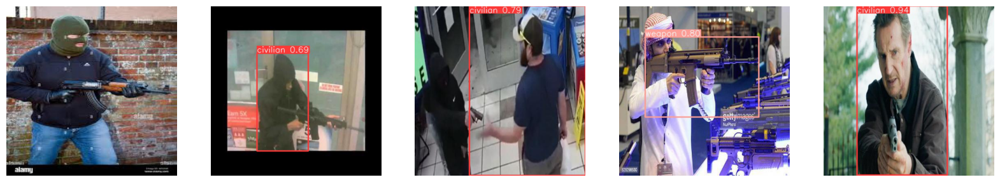

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=5, figsize=(20, 4))
image_paths = glob.glob("/content/drive/MyDrive/detect_terrorists/testing_results/civilian/*.jpg")[:5]

for i, img_path in enumerate(image_paths):
    img = Image.open(img_path)
    axes[i].imshow(img)
    axes[i].axis("off")
plt.show()

## 🔥 Load civilian_model and retrain it on military dataset


In [ ]:
!yolo task=detect mode=train model=/content/drive/MyDrive/detect_terrorists/training_results/civilian/weights/best.pt data=/content/drive/MyDrive/detect_terrorists/military_dataset/data.yaml epochs=200 imgsz=640 batch=32 project=/content/drive/MyDrive/detect_terrorists/training_results name=military_civilian

Ultralytics YOLOv8.0.132 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=detect, mode=train, model=/content/drive/MyDrive/detect_terrorists/training_results/civilian/weights/best.pt, data=/content/drive/MyDrive/detect_terrorists/military_dataset/data.yaml, epochs=100, patience=50, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/detect_terrorists/training_results, name=military_civilian, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, lin

## ⚖️ Evaluate military civilian model

**NOTE:** As with the regular YOLOv8 training, we can now take a look at artifacts stored in `runs` directory.

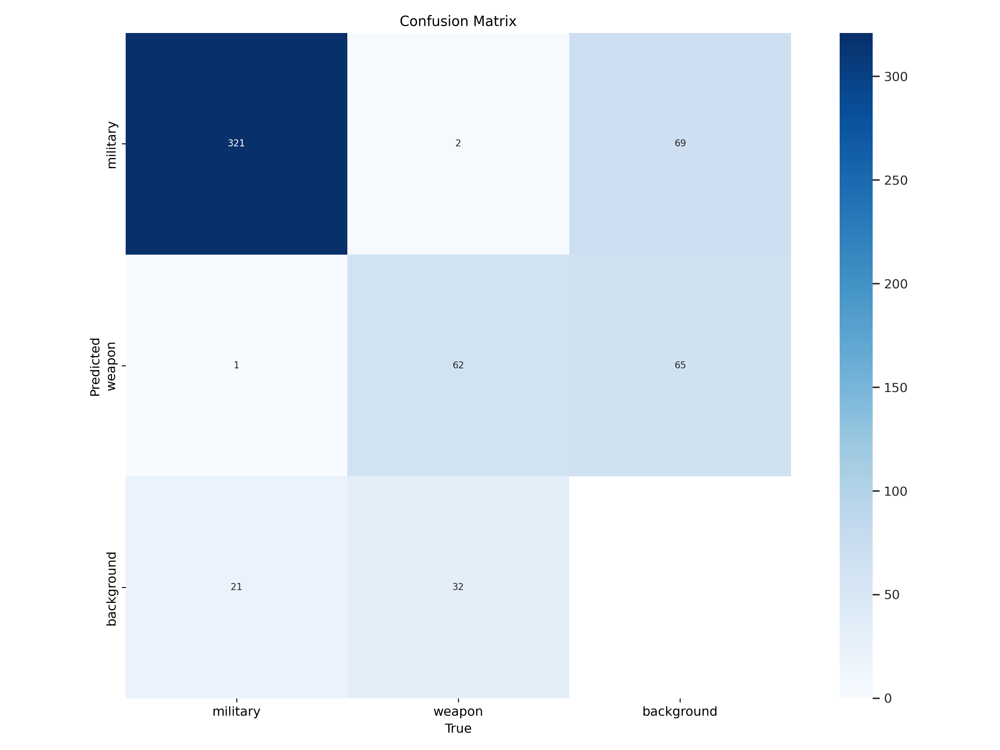

In [ ]:
from IPython.display import Image
Image(filename='/content/drive/MyDrive/detect_terrorists/training_results/military_civilian/confusion_matrix.png', width=1000)

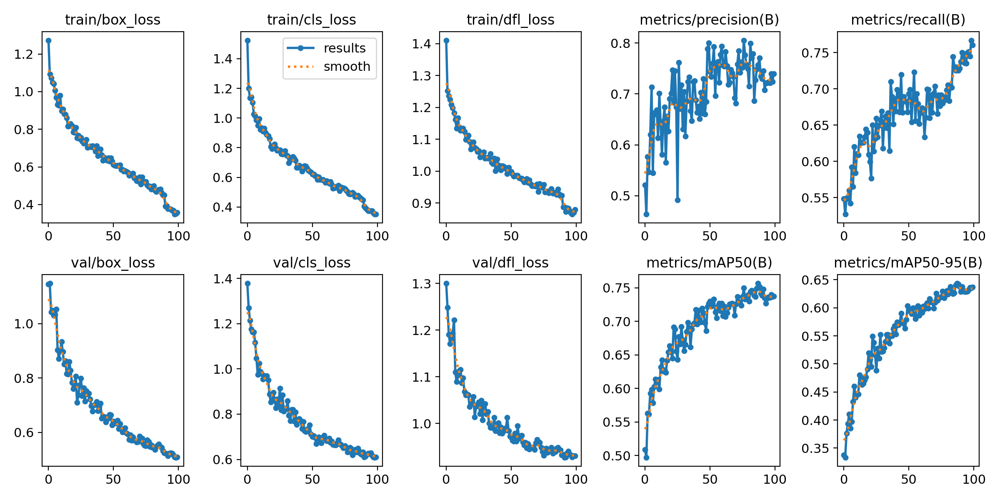

In [ ]:
Image(filename='/content/drive/MyDrive/detect_terrorists/training_results/military_civilian/results.png', width=1000)

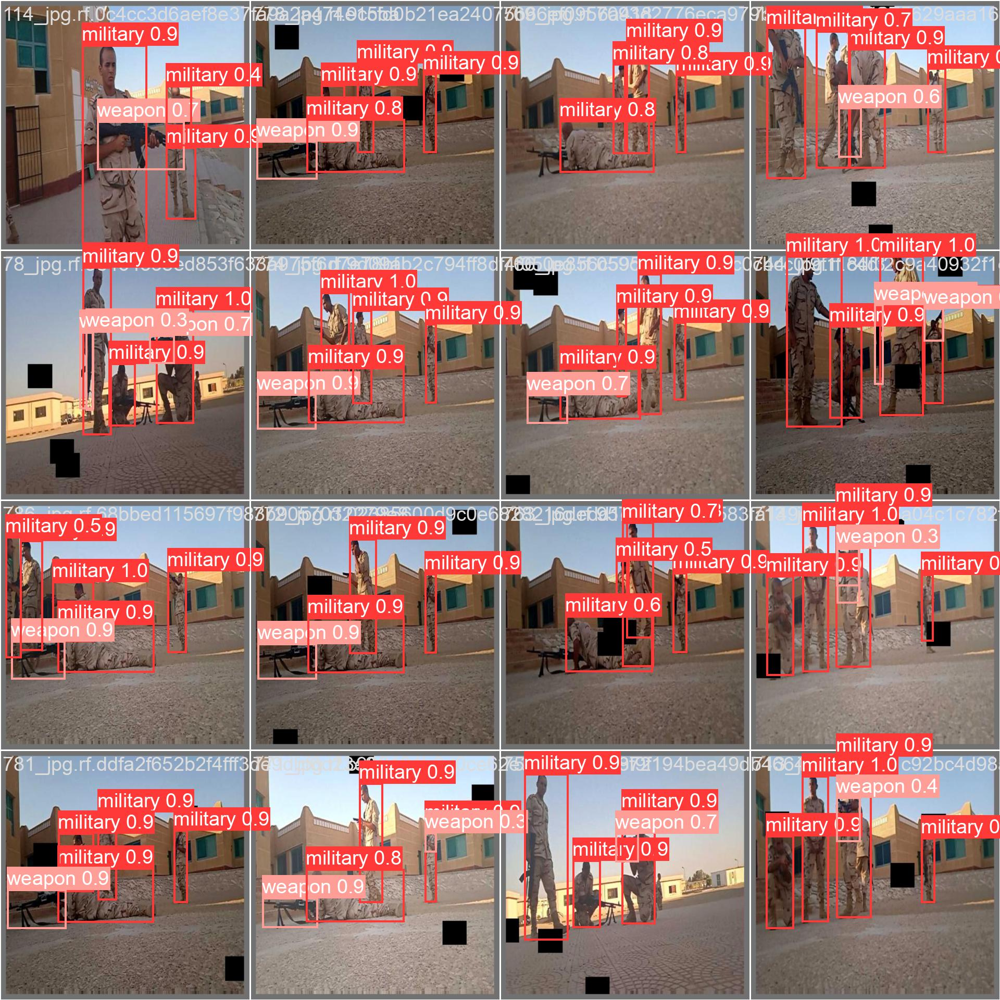

In [ ]:
Image(filename='/content/drive/MyDrive/detect_terrorists/training_results/military_civilian/val_batch0_pred.jpg', width=1000)

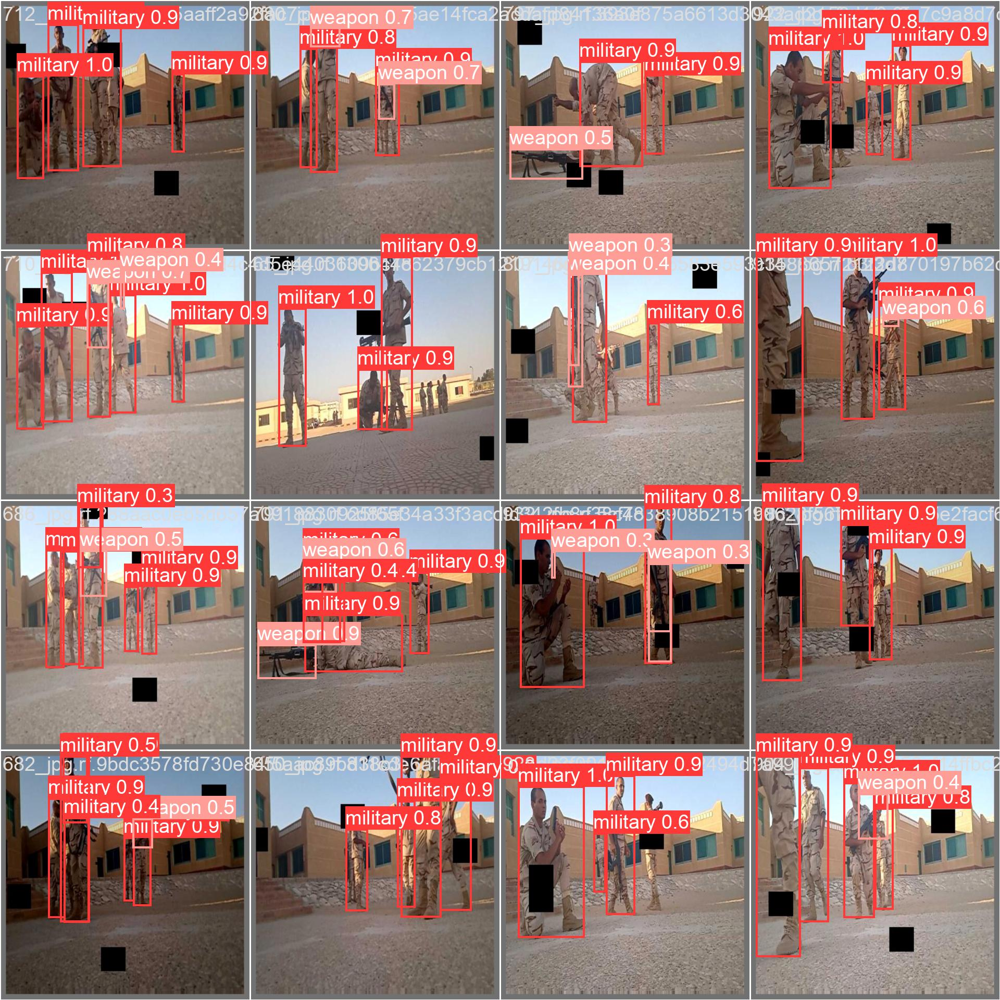

In [ ]:
Image(filename='/content/drive/MyDrive/detect_terrorists/training_results/military_civilian/val_batch1_pred.jpg', width=1000)

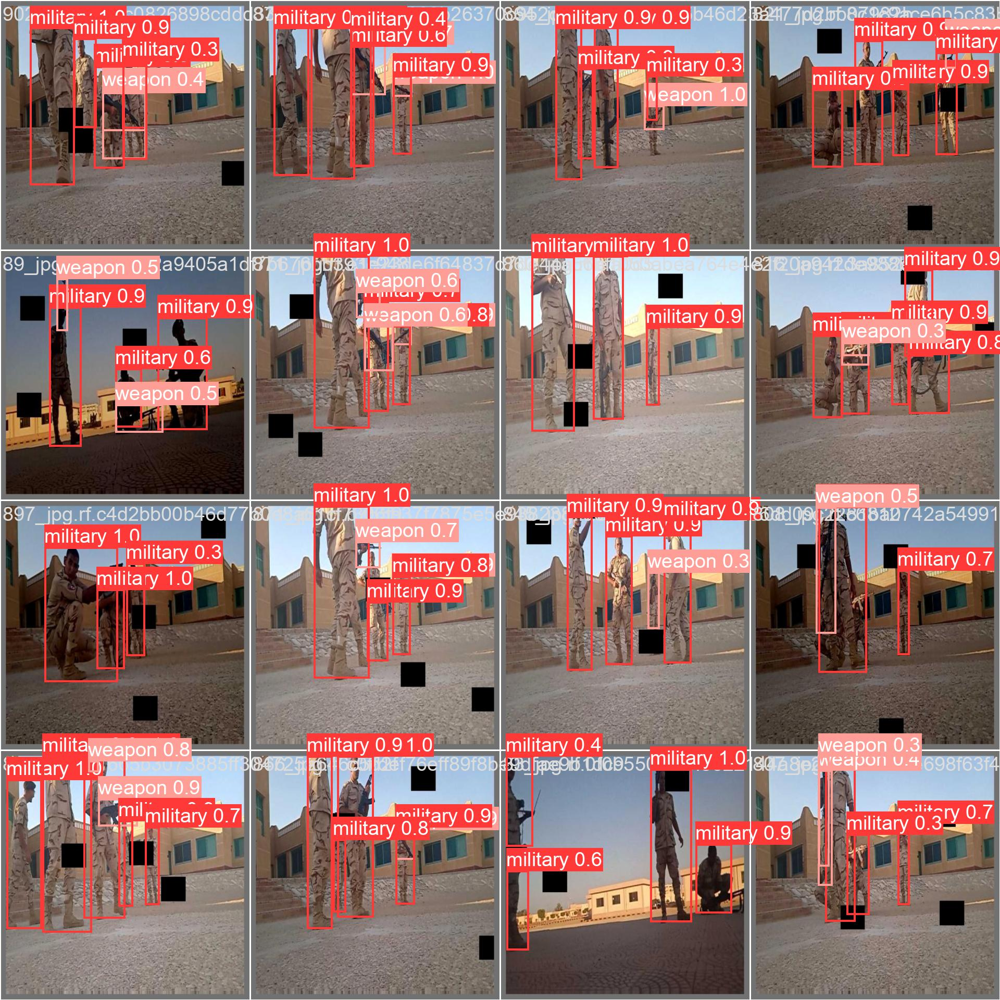

In [ ]:
Image(filename='/content/drive/MyDrive/detect_terrorists/training_results/military_civilian/val_batch2_pred.jpg', width=1000)

## 🔥 Predict on military dataset

In [ ]:
import glob
import matplotlib.pyplot as plt
from PIL import Image

Befor predict

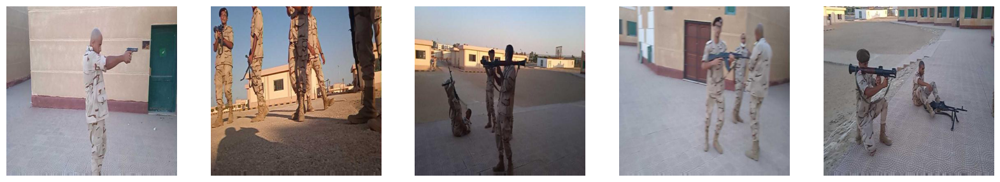

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=5, figsize=(20, 4))
image_paths = glob.glob("/content/drive/MyDrive/detect_terrorists/military_dataset/test/images/*.jpg")[:5]

for i, img_path in enumerate(image_paths):
    img = Image.open(img_path)
    axes[i].imshow(img)
    axes[i].axis("off")
plt.show()

preict

In [ ]:
!yolo task=detect mode=predict model=/content/drive/MyDrive/detect_terrorists/training_results/military_civilian/weights/best.pt conf=0.55 project=/content/drive/MyDrive/detect_terrorists/testing_results name=military_civilian source=/content/drive/MyDrive/detect_terrorists/military_dataset/test/images

After predcit

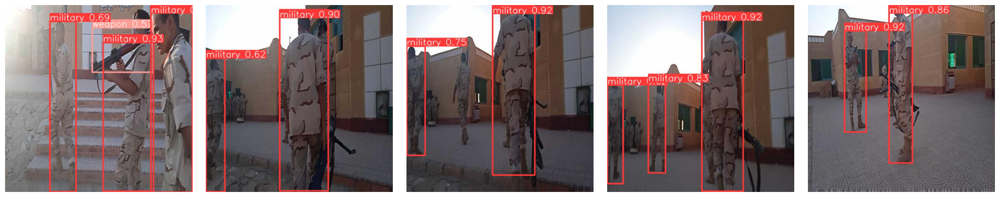

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=5, figsize=(20, 4))
image_paths = glob.glob("/content/drive/MyDrive/detect_terrorists/testing_results/military_civilian/*.jpg")[:5]
for i, img_path in enumerate(image_paths):
    img = Image.open(img_path)
    axes[i].imshow(img)
    axes[i].axis("off")
plt.show()

# 🎬 Run Inference on a videos

In [ ]:
from moviepy.editor import VideoFileClip
from IPython.display import display

## Vid 1

Befor predict

In [ ]:
video_path = "/content/drive/MyDrive/detect_terrorists/testing_results/vid1.mp4"
# Load the video using moviepy and display it
video = VideoFileClip(video_path)
display(video.ipython_display(maxduration=1000, width="480"))

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


Predict

In [ ]:
!yolo task=detect mode=predict model=/content/drive/MyDrive/detect_terrorists/training_results/military_civilian/weights/best.pt conf=0.55 project=/content/drive/MyDrive/detect_terrorists/testing_results source=/content/drive/MyDrive/detect_terrorists/testing_results/vid1.mp4


After predict

In [ ]:
video_path = "/content/drive/MyDrive/detect_terrorists/testing_results/predict/vid1.avi"
# Load the video using moviepy and display it
video = VideoFileClip(video_path)
display(video.ipython_display(maxduration=1000, width="480"))

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


## Vid 2

Befor predict

In [ ]:
video_path = "/content/drive/MyDrive/detect_terrorists/testing_results/vid2.mp4"
# Load the video using moviepy and display it
video = VideoFileClip(video_path)
display(video.ipython_display(maxduration=1000, width="480"))

Predict

In [ ]:
!yolo task=detect mode=predict model=/content/drive/MyDrive/detect_terrorists/training_results/military_civilian/weights/best.pt conf=0.50 project=/content/drive/MyDrive/detect_terrorists/testing_results source=/content/drive/MyDrive/detect_terrorists/testing_results/vid2.mp4


Ultralytics YOLOv8.0.132 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 268 layers, 43608150 parameters, 0 gradients

video 1/1 (1/2094) /content/drive/MyDrive/detect_terrorists/testing_results/vid2.mp4: 384x640 (no detections), 69.1ms
video 1/1 (2/2094) /content/drive/MyDrive/detect_terrorists/testing_results/vid2.mp4: 384x640 (no detections), 32.4ms
video 1/1 (3/2094) /content/drive/MyDrive/detect_terrorists/testing_results/vid2.mp4: 384x640 (no detections), 32.4ms
video 1/1 (4/2094) /content/drive/MyDrive/detect_terrorists/testing_results/vid2.mp4: 384x640 (no detections), 32.4ms
video 1/1 (5/2094) /content/drive/MyDrive/detect_terrorists/testing_results/vid2.mp4: 384x640 (no detections), 32.3ms
video 1/1 (6/2094) /content/drive/MyDrive/detect_terrorists/testing_results/vid2.mp4: 384x640 (no detections), 24.2ms
video 1/1 (7/2094) /content/drive/MyDrive/detect_terrorists/testing_results/vid2.mp4: 384x640 (no detections), 21.8ms
video 1/1 (8/2094

After predict

In [ ]:
video_path = "/content/drive/MyDrive/detect_terrorists/testing_results/predict2/vid2.avi"
# Load the video using moviepy and display it
video = VideoFileClip(video_path)
display(video.ipython_display(maxduration=1000, width="480"))

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4
